In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
pip install segmentation-models

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.7/50.7 kB 2.3 MB/s eta 0:00:00


In [2]:
pip install tensorflow-io==0.27.0

In [3]:
pip install tensorflow==2.10.0

In [4]:
import tensorflow as tf

In [5]:
from PIL import Image
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
os.environ["SM_FRAMEWORK"] = "tf.keras"

import segmentation_models as sm
import matplotlib.pyplot as plt
import tensorflow_io as tfio
import tensorflow as tf

Segmentation Models: using `tf.keras` framework.


In [6]:
root = r'/content/drive/MyDrive/archive'
exts = ('jpg', 'JPG', 'png', 'PNG', 'tif', 'gif', 'ppm')

In [7]:
import os
input_data = os.path.join(root, 'DRIVE/training/images')
images = sorted(
    [
        os.path.join(input_data, fname)
        for fname in os.listdir(input_data)
        if fname.endswith(exts) and not fname.startswith(".")
    ]
)

In [8]:
target_data = os.path.join(root, 'DRIVE/training/1st_manual')
masks = sorted(
    [
        os.path.join(target_data, fname)
        for fname in os.listdir(target_data)
        if fname.endswith(exts) and not fname.startswith(".")
    ]
)

In [9]:
print("Number of samples:", len(images), len(masks))
for input_path, target_path in zip(images[:10], masks[:10]):
    print(input_path[-31:], "|", target_path[-34:])

Number of samples: 20 20
training/images/21_training.tif | training/1st_manual/21_manual1.gif
training/images/22_training.tif | training/1st_manual/22_manual1.gif
training/images/23_training.tif | training/1st_manual/23_manual1.gif
training/images/24_training.tif | training/1st_manual/24_manual1.gif
training/images/25_training.tif | training/1st_manual/25_manual1.gif
training/images/26_training.tif | training/1st_manual/26_manual1.gif
training/images/27_training.tif | training/1st_manual/27_manual1.gif
training/images/28_training.tif | training/1st_manual/28_manual1.gif
training/images/29_training.tif | training/1st_manual/29_manual1.gif
training/images/30_training.tif | training/1st_manual/30_manual1.gif


**COMPARISON**

NORMAL **RETINA**

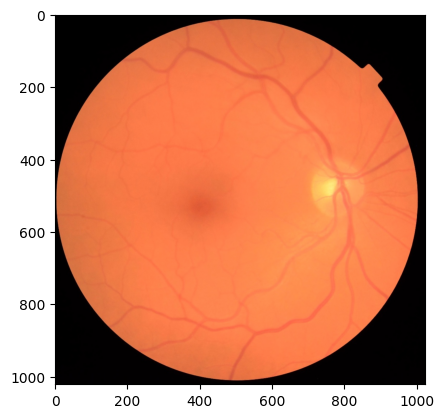

In [12]:
!pip install Pillow

from PIL import Image
import matplotlib.pyplot as plt

# Specify the filename of the image file
image_filename = '/content/drive/MyDrive/archive/31_right.jpeg'

# Open the image using PIL
image1 = Image.open(image_filename)

# Display the image
plt.imshow(image1)
plt.show()


ABNORMAL **RETINA**

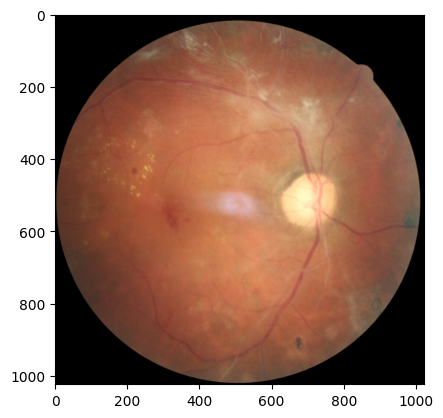

In [11]:
!pip install Pillow

from PIL import Image
import matplotlib.pyplot as plt

# Specify the filename of the image file
image_filename = '/content/drive/MyDrive/archive/294_right.jpeg'

# Open the image using PIL
image2 = Image.open(image_filename)

# Display the image
plt.imshow(image2)
plt.show()


In [13]:
!pip install scikit-image
import cv2
import numpy as np
!pip install opencv-python
# from skimage.filters import skeletonize
from skimage.morphology import skeletonize

def extract_blood_vessels(image):

  # Convert the image to grayscale
  grayscale_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

  # Apply thresholding to binarize the image
  threshold, binary_image = cv2.threshold(grayscale_image, 150, 255, cv2.THRESH_BINARY)

  # Clip the pixel values to the range [0, 1]
  binary_image = np.clip(binary_image, 0, 1)

  # Return the binary image
  return binary_image



**BRANCH COUNTING BETWEEN NORMAL AND ABNORMAL RETINA**


In [14]:
# Define a function to count branches in a blood vessel image
def count_branches(blood_vessel_image):
  # Apply skeletonization to thin the blood vessels
  skeleton_image = skeletonize(blood_vessel_image)

  # suitable datatype conversion
  skeleton_image = skeleton_image.astype(np.uint8)

  # Find the endpoints of the skeleton
  endpoints = cv2.findNonZero(skeleton_image)

  # Count the number of endpoints
  branch_points = 0
  for endpoint in endpoints:
    x, y = endpoint[0]
    neighbors = skeleton_image[y-1:y+2, x-1:x+2]
    if np.sum(neighbors) > 2:
      branch_points += 1

  # Return the number of branch points
  return branch_points

# Load the two images
image1 = cv2.imread("/content/drive/MyDrive/archive/682_right.jpeg")
image2 = cv2.imread("/content/drive/MyDrive/archive/294_right.jpeg")

# Extract blood vessels from both images
blood_vessels1 = extract_blood_vessels(image1)
blood_vessels2 = extract_blood_vessels(image2)

# Count the branches in each image
branches1 = count_branches(blood_vessels1)
branches2 = count_branches(blood_vessels2)

# Compare the number of branches
if branches1 > branches2:
  print("Image1 has more branches than image2.")
elif branches1 < branches2:
  print("Image2 has more branches than image1.")
else:
  print("Both images have the same number of branches.")

# Print the results
print(f"Number of branches in Normal Retina: {branches1}")
print(f"Number of branches in Abnormal Retina: {branches2}")

Image2 has more branches than image1.
Number of branches in Normal Retina: 231
Number of branches in Abnormal Retina: 19075


# **ABNORMAL RETINA HAS SIGNIFICANTLY HIGHER BRANCHES THAN NORMAL RETINA**

In [ ]:
COMPARISON BASED ON VESSEL SEGMENTATION

Normal Retina


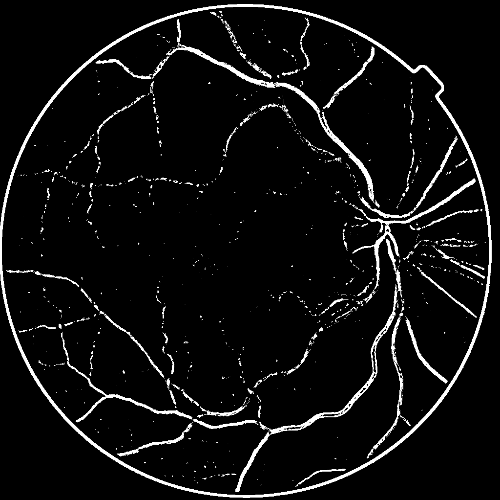

Abnormal Retina


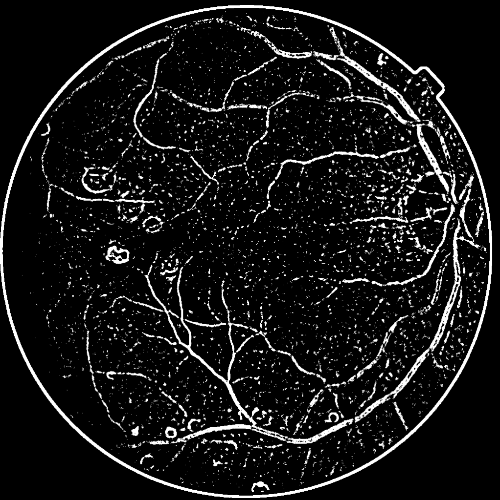

In [16]:
# Import necessary libraries
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# Define the image paths
normal_retina_path = "/content/drive/MyDrive/archive/31_right.jpeg"
abnormal_retina_path = "/content/drive/MyDrive/archive/217_right.jpeg"

# Read the images
normal_retina_image = cv2.imread(normal_retina_path)
abnormal_retina_image = cv2.imread(abnormal_retina_path)

# Converting images to greyscale
normal_retina_grayscale = cv2.cvtColor(normal_retina_image, cv2.COLOR_BGR2GRAY)
abnormal_retina_grayscale = cv2.cvtColor(abnormal_retina_image, cv2.COLOR_BGR2GRAY)


# Resize the images to have equal sizes
width = 30
height = 10
dim = (width, height)
normal_retina_resized = cv2.resize(normal_retina_image, dim, interpolation=cv2.INTER_AREA)
abnormal_retina_resized = cv2.resize(abnormal_retina_image, dim, interpolation=cv2.INTER_AREA)


# Apply median filtering to reduce noise
normal_retina_denoised = cv2.medianBlur(normal_retina_grayscale, 5)
abnormal_retina_denoised = cv2.medianBlur(abnormal_retina_grayscale, 5)

# Apply adaptive thresholding to segment the vessels
normal_retina_segmented = cv2.adaptiveThreshold(normal_retina_denoised, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 11, 2)
abnormal_retina_segmented = cv2.adaptiveThreshold(abnormal_retina_denoised, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 11, 2)

normal_retina_segmented = cv2.bitwise_not(normal_retina_segmented)
abnormal_retina_segmented = cv2.bitwise_not(abnormal_retina_segmented)

# Resize the abnormal retina image to match the normal retina image
abnormal_retina_segmented = cv2.resize(abnormal_retina_segmented, normal_retina_segmented.shape, interpolation=cv2.INTER_AREA)

# Concatenate the images horizontally
# concatenated_image = np.concatenate((normal_retina_segmented, abnormal_retina_segmented), axis=1)
# Resize the abnormal retina segmented image to a smaller size
resized_width = 500 # Set the width of the resized image
resized_height = 500
abnormal_retina_segmented_resized = cv2.resize(abnormal_retina_segmented, (resized_width, resized_height))
normal_retina_segmented_resized = cv2.resize(normal_retina_segmented, (resized_width, resized_height))

# Display the segmented images
print("Normal Retina")
cv2_imshow(normal_retina_segmented_resized)
print("Abnormal Retina")
cv2_imshow(abnormal_retina_segmented_resized)
# concatenated_image = np.concatenate((normal_retina_segmented, abnormal_retina_segmented_resized), axis=1)
# cv2_imshow(concatenated_image)


For example, here we download and display a PNG image of the Colab logo:

In [17]:
IMAGE_SIZE=512
BATCH_SIZE=12

def read_files(image_path, mask=False):
    image = tf.io.read_file(image_path)
    if mask:
        image = tf.io.decode_gif(image) # out: (1, h, w, 3)
        image = tf.squeeze(image) # out: (h, w, 3)
        image = tf.image.rgb_to_grayscale(image) # out: (h, w, 1)
        image = tf.divide(image, 128)
        image.set_shape([None, None, 1])
        image = tf.image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
        image = tf.cast(image, tf.int32)
    else:
        image = tfio.experimental.image.decode_tiff(image) # out: (h, w, 4)
        image = image[:,:,:3] # out: (h, w, 3)
        image.set_shape([None, None, 3])
        image = tf.image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
        image = image / 255.
    return image

In [18]:
def load_data(image_list, mask_list):
    image = read_files(image_list)
    mask  = read_files(mask_list, mask=True)
    return image, mask

In [19]:
def data_generator(image_list, mask_list):
    dataset = tf.data.Dataset.from_tensor_slices((image_list, mask_list))
    dataset = dataset.map(load_data, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE, drop_remainder=False)
    return dataset

In [20]:
import tensorflow_io as tfio
train_dataset = data_generator(images, masks)
train_dataset

<BatchDataset element_spec=(TensorSpec(shape=(None, 512, 512, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 512, 512, 1), dtype=tf.int32, name=None))>

In [21]:
def visualize(**images):
    """PLot images in one row."""
    n = len(images)
    plt.figure(figsize=(20, 20))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        plt.imshow(image, cmap='gray')
    plt.show()

(12, 512, 512, 3) (12, 512, 512, 1)
0 1
[0 1]


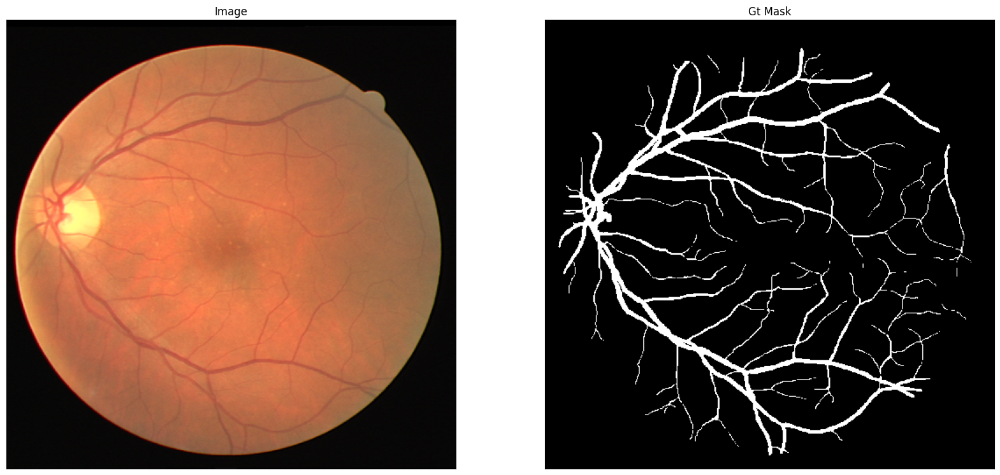

0 1
[0 1]


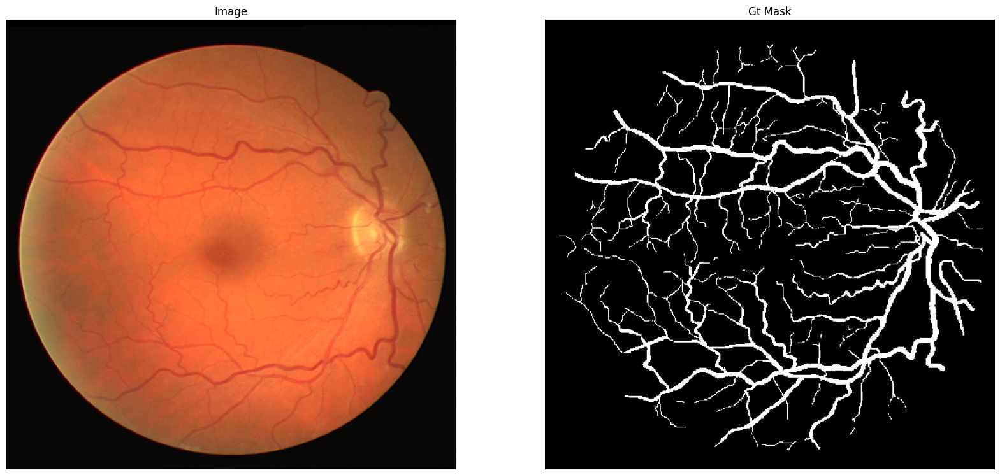

0 1
[0 1]


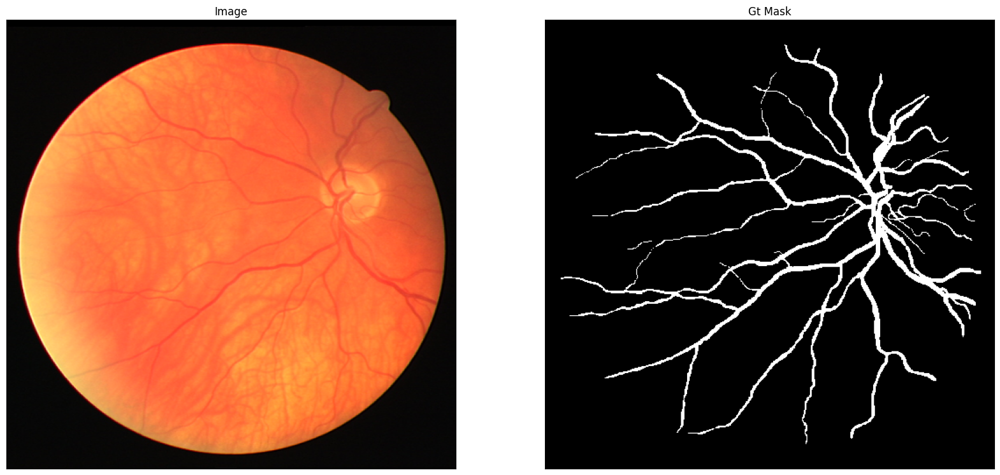

0 1
[0 1]


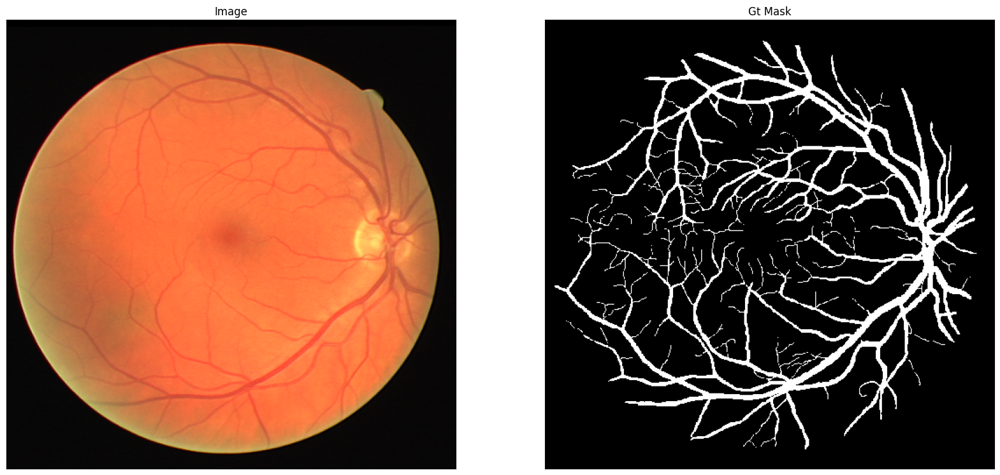

0 1
[0 1]


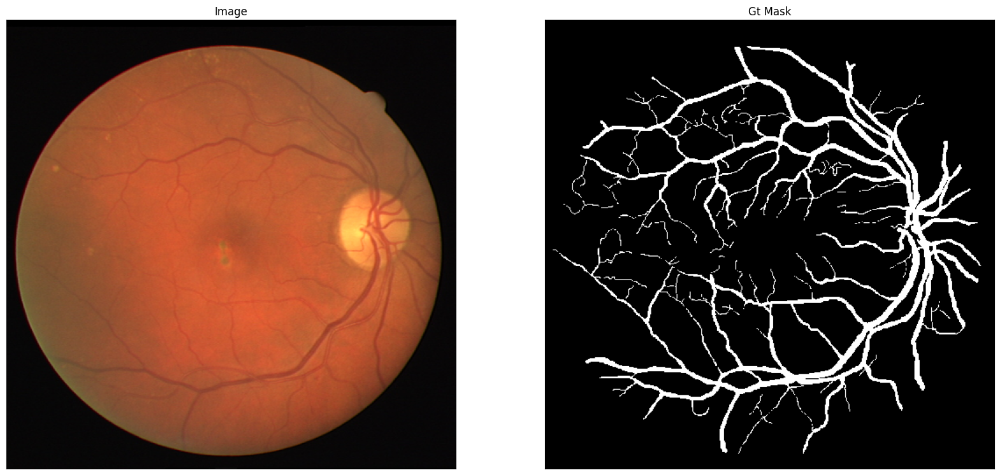

0 1
[0 1]


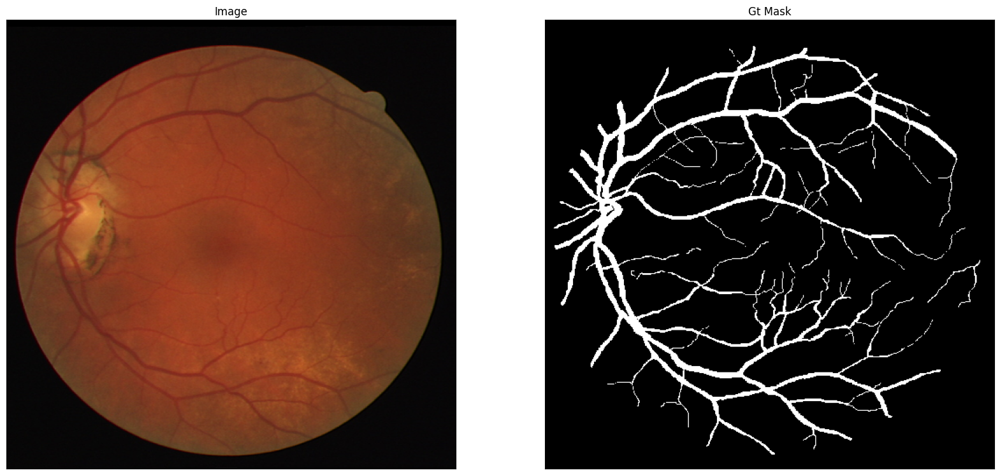

0 1
[0 1]


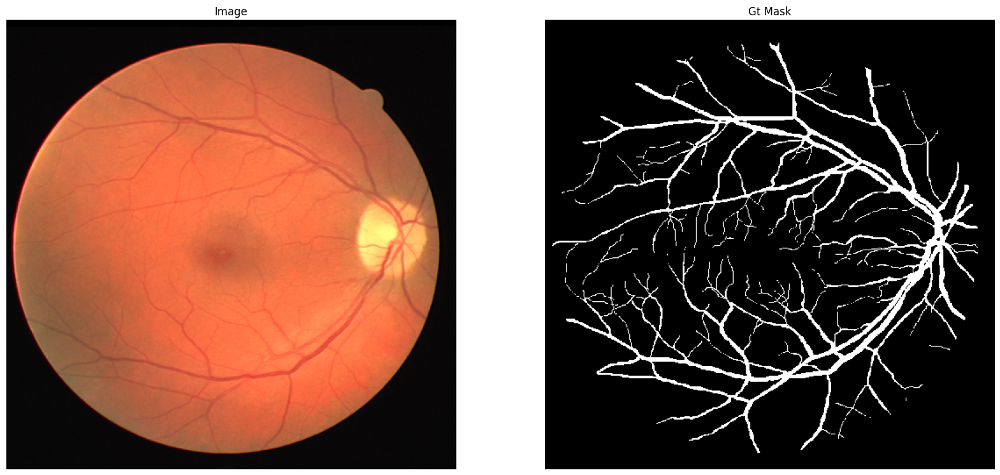

0 1
[0 1]


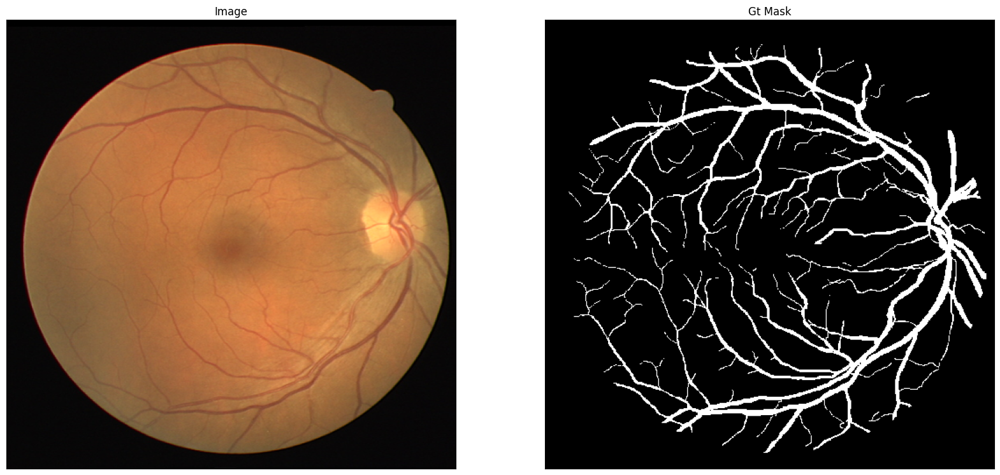

0 1
[0 1]


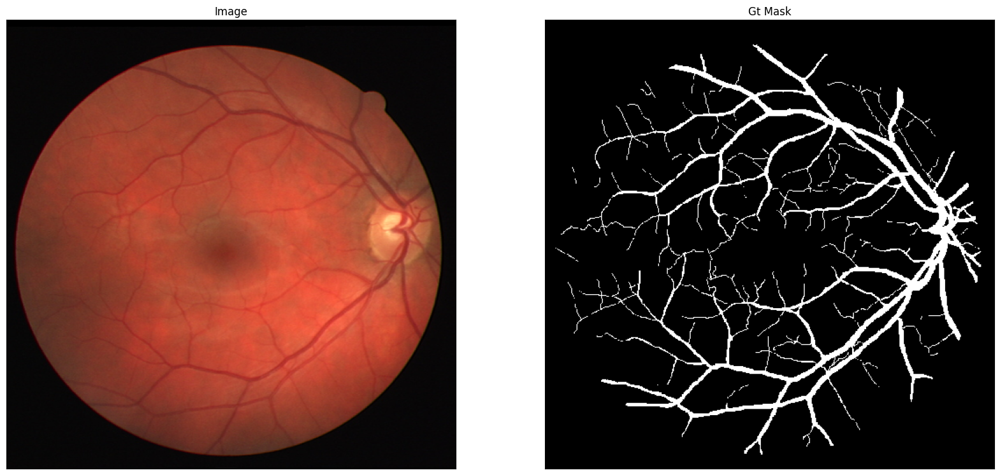

0 1
[0 1]


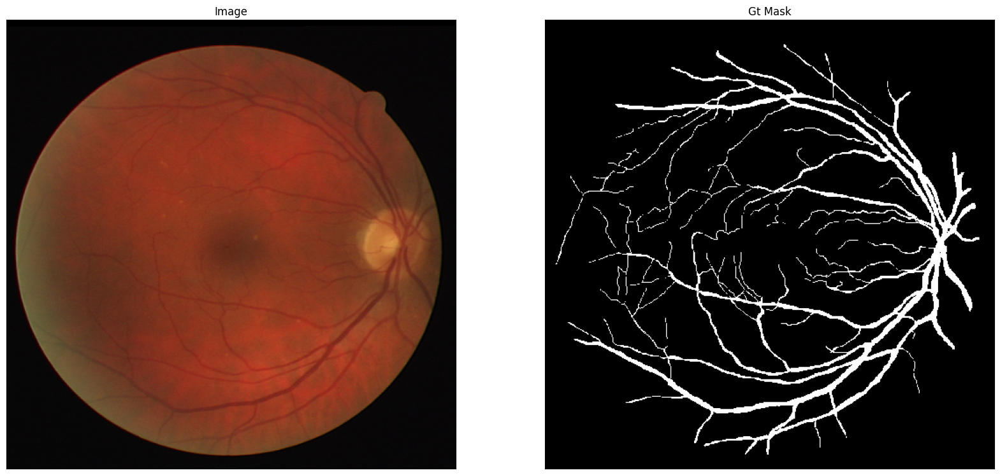

In [22]:
image, mask = next(iter(train_dataset.take(1)))
print(image.shape, mask.shape)

for (img, msk) in zip(image[:10], mask[:10]):
    print(mask.numpy().min(), mask.numpy().max())
    print(np.unique(mask.numpy()))
    visualize(
        image=img.numpy(),
        gt_mask=msk.numpy(),
    )

In [23]:
import segmentation_models as sm

Model: "model"
______________________________________________________________________________________________________________
 Layer (type)                       Output Shape            Param #      Connected to                         
 input_1 (InputLayer)               [(None, None, None, 3)  0            []                                   
                                    ]                                                                         
                                                                                                              
 stem_conv (Conv2D)                 (None, None, None, 32)  864          ['input_1[0][0]']                    
                                                                                                              
 stem_bn (BatchNormalization)       (None, None, None, 32)  128          ['stem_conv[0][0]']                  
                                                                                                 

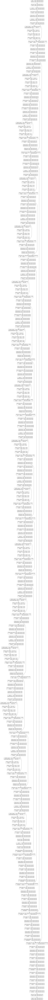

In [25]:
from tensorflow import keras

from tensorflow.keras.utils import plot_model
!pip install pydot graphviz

keras.backend.clear_session()
BACKBONE   = 'efficientnetb0'
n_classes  = 1
activation = 'sigmoid'
model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
model.summary(line_length=110)
plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

In [ ]:
class DisplayCallback(keras.callbacks.Callback):
    def __init__(self, dataset, epoch_interval=5):
        self.dataset = dataset
        self.epoch_interval = epoch_interval

    def display(self, display_list, extra_title=''):
        plt.figure(figsize=(15, 15))
        title = ['Input Image', 'True Mask', 'Predicted Mask']

        if len(display_list) > len(title):
            title.append(extra_title)

        for i in range(len(display_list)):
            plt.subplot(1, len(display_list), i+1)
            plt.title(title[i])
            plt.imshow(display_list[i], cmap='gray')
            plt.axis('off')
        plt.show()

    def create_mask(self, pred_mask):
        pred_mask = (pred_mask > 0.5).astype("int32")
        return pred_mask[0]

    def show_predictions(self, dataset, num=1):
        for image, mask in dataset.take(num):
            pred_mask = model.predict(image)
            self.display([image[0], mask[0], self.create_mask(pred_mask)])

    def on_epoch_end(self, epoch, logs=None):
        if epoch and epoch % self.epoch_interval == 0:
            self.show_predictions(self.dataset)
            print ('\nSample Prediction after epoch {}\n'.format(epoch+1))

Epoch 1/200
2/2 [==============================] - 206s 63s/step - loss: 0.7748 - accuracy: 0.4149
Epoch 2/200
2/2 [==============================] - 137s 49s/step - loss: 0.7418 - accuracy: 0.4753
Epoch 3/200
2/2 [==============================] - 137s 56s/step - loss: 0.7136 - accuracy: 0.5316
Epoch 4/200
2/2 [==============================] - 159s 74s/step - loss: 0.6889 - accuracy: 0.5767
Epoch 5/200
2/2 [==============================] - 156s 54s/step - loss: 0.6678 - accuracy: 0.6079
Epoch 6/200
1/1 [==============================] - 12s 12s/stepss: 0.6496 - accuracy: 0.6291


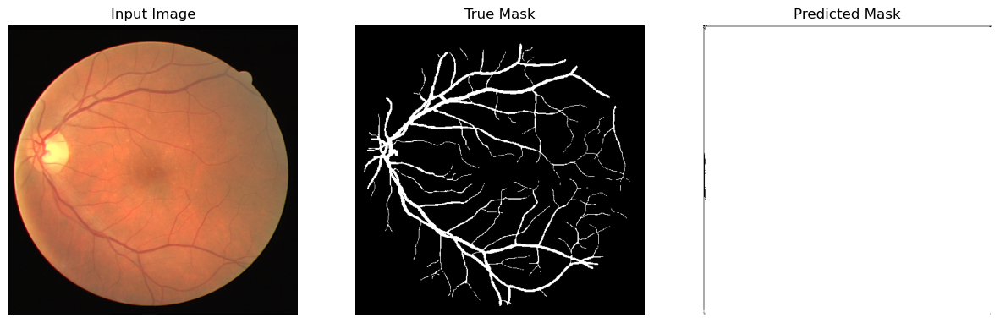


Sample Prediction after epoch 6

2/2 [==============================] - 139s 64s/step - loss: 0.6496 - accuracy: 0.6291
Epoch 7/200
2/2 [==============================] - 175s 97s/step - loss: 0.6334 - accuracy: 0.6461
Epoch 8/200
2/2 [==============================] - 121s 44s/step - loss: 0.6185 - accuracy: 0.6634
Epoch 9/200
2/2 [==============================] - 130s 53s/step - loss: 0.6044 - accuracy: 0.6819
Epoch 10/200
2/2 [==============================] - 122s 44s/step - loss: 0.5908 - accuracy: 0.7012
Epoch 11/200
1/1 [==============================] - 8s 8s/steploss: 0.5780 - accuracy: 0.7195


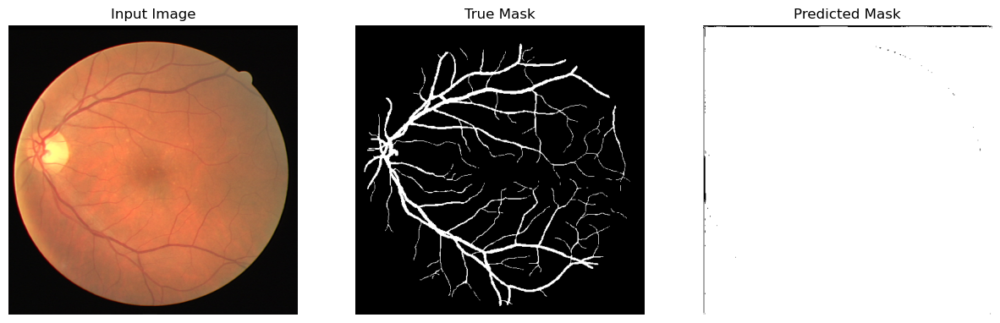


Sample Prediction after epoch 11

2/2 [==============================] - 132s 57s/step - loss: 0.5780 - accuracy: 0.7195
Epoch 12/200
2/2 [==============================] - 120s 42s/step - loss: 0.5660 - accuracy: 0.7377
Epoch 13/200
2/2 [==============================] - 129s 47s/step - loss: 0.5546 - accuracy: 0.7546
Epoch 14/200
2/2 [==============================] - 115s 42s/step - loss: 0.5438 - accuracy: 0.7704
Epoch 15/200
2/2 [==============================] - 124s 44s/step - loss: 0.5333 - accuracy: 0.7852
Epoch 16/200
1/1 [==============================] - 9s 9s/steploss: 0.5235 - accuracy: 0.7986


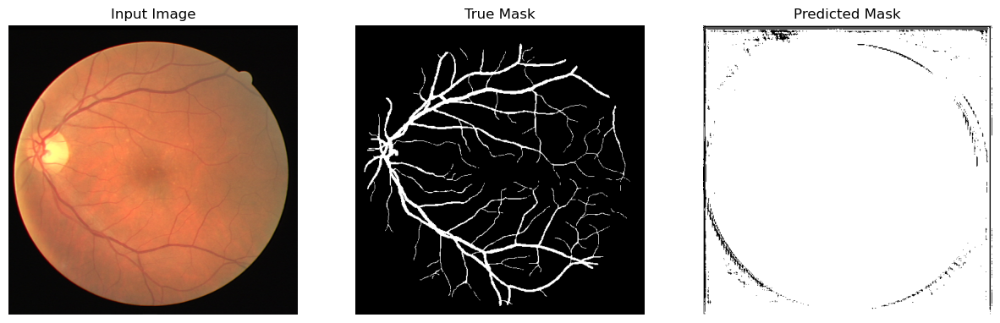


Sample Prediction after epoch 16

2/2 [==============================] - 132s 55s/step - loss: 0.5235 - accuracy: 0.7986
Epoch 17/200
2/2 [==============================] - 129s 49s/step - loss: 0.5138 - accuracy: 0.8116
Epoch 18/200
2/2 [==============================] - 144s 50s/step - loss: 0.5047 - accuracy: 0.8237
Epoch 19/200
2/2 [==============================] - 125s 49s/step - loss: 0.4957 - accuracy: 0.8354
Epoch 20/200
2/2 [==============================] - 196s 80s/step - loss: 0.4872 - accuracy: 0.8466
Epoch 21/200
1/1 [==============================] - 19s 19s/stepss: 0.4789 - accuracy: 0.8570


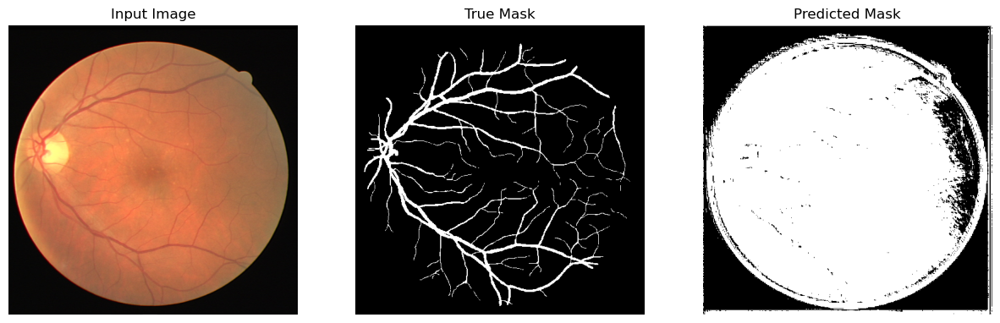


Sample Prediction after epoch 21

2/2 [==============================] - 287s 139s/step - loss: 0.4789 - accuracy: 0.8570
Epoch 22/200
2/2 [==============================] - 269s 104s/step - loss: 0.4710 - accuracy: 0.8666
Epoch 23/200
2/2 [==============================] - 222s 89s/step - loss: 0.4635 - accuracy: 0.8750
Epoch 24/200
2/2 [==============================] - 238s 84s/step - loss: 0.4565 - accuracy: 0.8820
Epoch 25/200
2/2 [==============================] - 272s 132s/step - loss: 0.4492 - accuracy: 0.8888
Epoch 26/200
1/1 [==============================] - 19s 19s/stepss: 0.4422 - accuracy: 0.8951


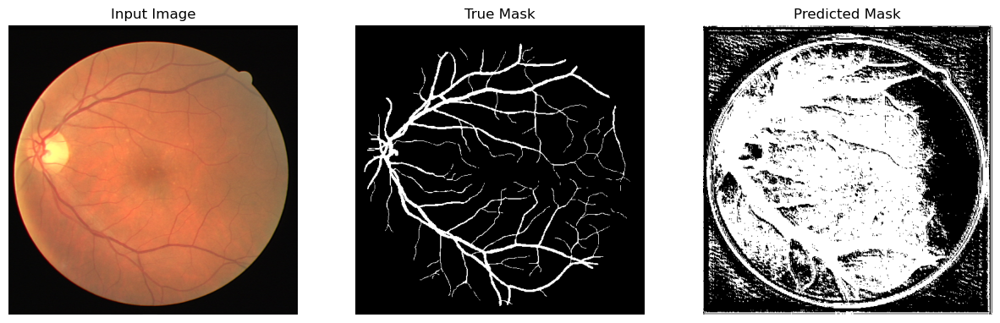


Sample Prediction after epoch 26

2/2 [==============================] - 326s 143s/step - loss: 0.4422 - accuracy: 0.8951
Epoch 27/200
2/2 [==============================] - 323s 101s/step - loss: 0.4353 - accuracy: 0.9009
Epoch 28/200
2/2 [==============================] - 278s 103s/step - loss: 0.4292 - accuracy: 0.9059
Epoch 29/200
2/2 [==============================] - 283s 115s/step - loss: 0.4224 - accuracy: 0.9111
Epoch 30/200
2/2 [==============================] - 336s 166s/step - loss: 0.4161 - accuracy: 0.9158
Epoch 31/200
1/1 [==============================] - 22s 22s/stepss: 0.4101 - accuracy: 0.9200


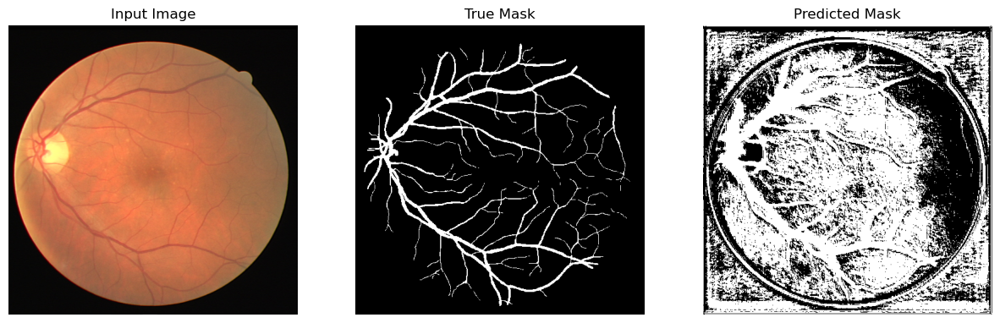


Sample Prediction after epoch 31

2/2 [==============================] - 308s 134s/step - loss: 0.4101 - accuracy: 0.9200
Epoch 32/200
2/2 [==============================] - 201s 71s/step - loss: 0.4041 - accuracy: 0.9234
Epoch 33/200
2/2 [==============================] - 239s 96s/step - loss: 0.3984 - accuracy: 0.9265
Epoch 34/200
2/2 [==============================] - 220s 81s/step - loss: 0.3927 - accuracy: 0.9295
Epoch 35/200
2/2 [==============================] - 213s 73s/step - loss: 0.3877 - accuracy: 0.9317
Epoch 36/200
1/1 [==============================] - 14s 14s/stepss: 0.3824 - accuracy: 0.9338


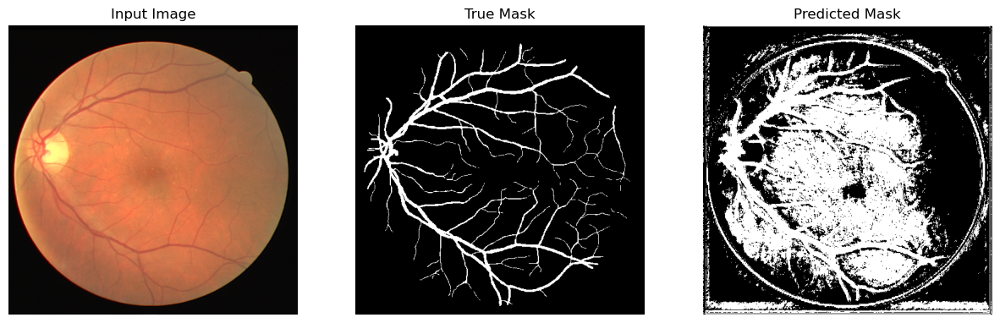


Sample Prediction after epoch 36

2/2 [==============================] - 231s 100s/step - loss: 0.3824 - accuracy: 0.9338
Epoch 37/200
2/2 [==============================] - 196s 76s/step - loss: 0.3772 - accuracy: 0.9362
Epoch 38/200
2/2 [==============================] - 184s 67s/step - loss: 0.3725 - accuracy: 0.9380
Epoch 39/200
2/2 [==============================] - 192s 71s/step - loss: 0.3680 - accuracy: 0.9395
Epoch 40/200
2/2 [==============================] - 182s 75s/step - loss: 0.3631 - accuracy: 0.9413
Epoch 41/200
1/1 [==============================] - 12s 12s/stepss: 0.3586 - accuracy: 0.9430


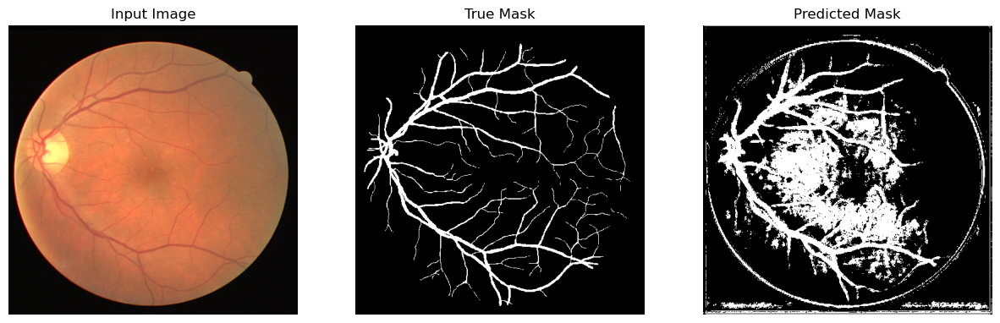


Sample Prediction after epoch 41

2/2 [==============================] - 231s 95s/step - loss: 0.3586 - accuracy: 0.9430
Epoch 42/200
2/2 [==============================] - 171s 69s/step - loss: 0.3539 - accuracy: 0.9445
Epoch 43/200
2/2 [==============================] - 173s 61s/step - loss: 0.3496 - accuracy: 0.9458
Epoch 44/200
2/2 [==============================] - 158s 56s/step - loss: 0.3453 - accuracy: 0.9472
Epoch 45/200
2/2 [==============================] - 166s 63s/step - loss: 0.3413 - accuracy: 0.9486
Epoch 46/200
1/1 [==============================] - 11s 11s/stepss: 0.3377 - accuracy: 0.9494


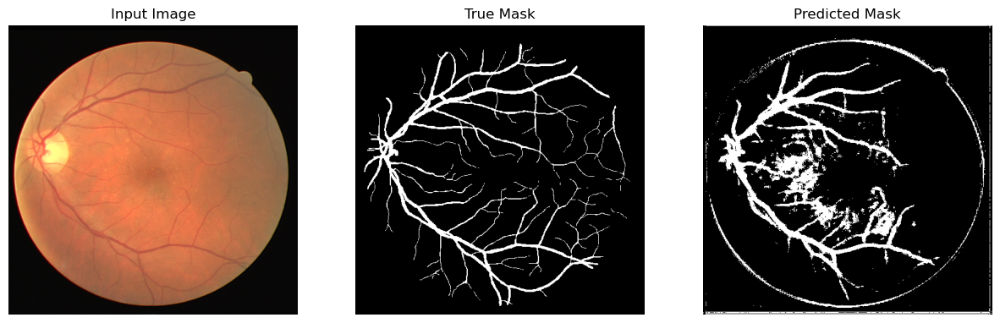


Sample Prediction after epoch 46

2/2 [==============================] - 180s 77s/step - loss: 0.3377 - accuracy: 0.9494
Epoch 47/200
2/2 [==============================] - 167s 65s/step - loss: 0.3336 - accuracy: 0.9504
Epoch 48/200
2/2 [==============================] - 184s 70s/step - loss: 0.3297 - accuracy: 0.9516
Epoch 49/200
2/2 [==============================] - 216s 69s/step - loss: 0.3260 - accuracy: 0.9523
Epoch 50/200
2/2 [==============================] - 178s 69s/step - loss: 0.3221 - accuracy: 0.9533
Epoch 51/200
1/1 [==============================] - 12s 12s/stepss: 0.3185 - accuracy: 0.9544


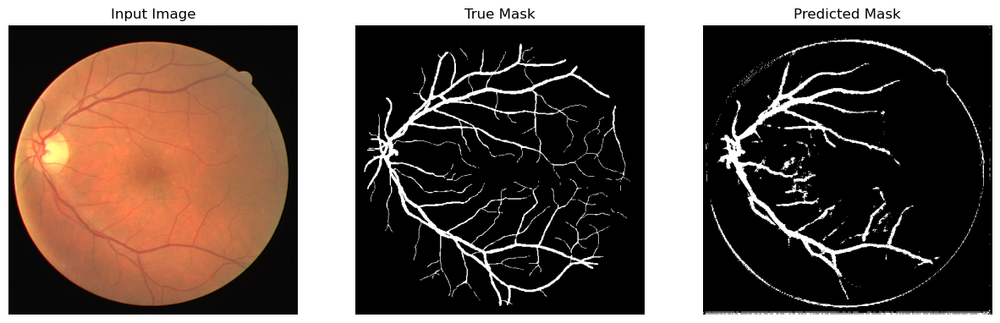


Sample Prediction after epoch 51

2/2 [==============================] - 175s 74s/step - loss: 0.3185 - accuracy: 0.9544
Epoch 52/200
2/2 [==============================] - 164s 68s/step - loss: 0.3148 - accuracy: 0.9552
Epoch 53/200
2/2 [==============================] - 176s 61s/step - loss: 0.3113 - accuracy: 0.9559
Epoch 54/200
2/2 [==============================] - 161s 56s/step - loss: 0.3082 - accuracy: 0.9564
Epoch 55/200
2/2 [==============================] - 160s 62s/step - loss: 0.3045 - accuracy: 0.9571
Epoch 56/200
1/1 [==============================] - 12s 12s/stepss: 0.3005 - accuracy: 0.9582


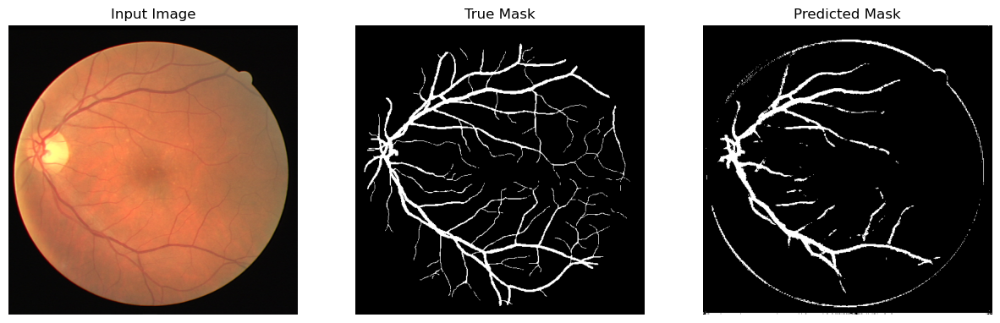


Sample Prediction after epoch 56

2/2 [==============================] - 203s 92s/step - loss: 0.3005 - accuracy: 0.9582
Epoch 57/200
2/2 [==============================] - 162s 65s/step - loss: 0.2972 - accuracy: 0.9587
Epoch 58/200
2/2 [==============================] - 170s 67s/step - loss: 0.2930 - accuracy: 0.9596
Epoch 59/200
2/2 [==============================] - 180s 75s/step - loss: 0.2898 - accuracy: 0.9601
Epoch 60/200
2/2 [==============================] - 174s 62s/step - loss: 0.2863 - accuracy: 0.9605
Epoch 61/200
1/1 [==============================] - 11s 11s/stepss: 0.2827 - accuracy: 0.9612


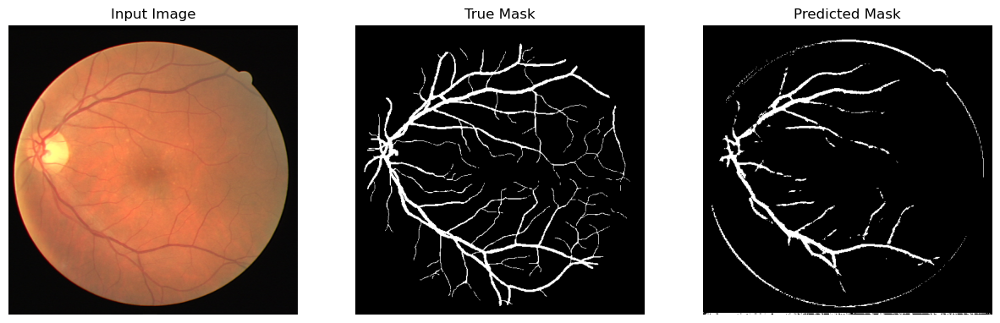


Sample Prediction after epoch 61

2/2 [==============================] - 190s 75s/step - loss: 0.2827 - accuracy: 0.9612
Epoch 62/200
2/2 [==============================] - 173s 66s/step - loss: 0.2794 - accuracy: 0.9619
Epoch 63/200
2/2 [==============================] - 204s 70s/step - loss: 0.2764 - accuracy: 0.9622
Epoch 64/200
2/2 [==============================] - 164s 72s/step - loss: 0.2734 - accuracy: 0.9625
Epoch 65/200
2/2 [==============================] - 173s 68s/step - loss: 0.2704 - accuracy: 0.9630
Epoch 66/200
1/1 [==============================] - 11s 11s/stepss: 0.2679 - accuracy: 0.9631


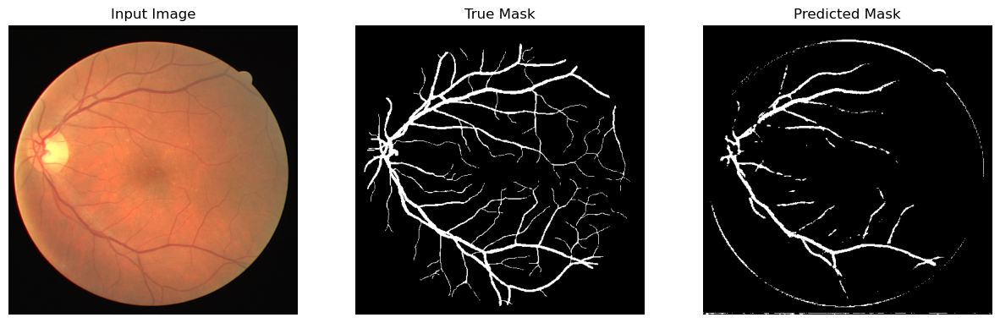


Sample Prediction after epoch 66

2/2 [==============================] - 182s 80s/step - loss: 0.2679 - accuracy: 0.9631
Epoch 67/200
2/2 [==============================] - 176s 63s/step - loss: 0.2655 - accuracy: 0.9630
Epoch 68/200
2/2 [==============================] - 155s 57s/step - loss: 0.2624 - accuracy: 0.9638
Epoch 69/200
2/2 [==============================] - 232s 77s/step - loss: 0.2599 - accuracy: 0.9642
Epoch 70/200
2/2 [==============================] - 170s 62s/step - loss: 0.2578 - accuracy: 0.9643
Epoch 71/200
1/1 [==============================] - 12s 12s/stepss: 0.2552 - accuracy: 0.9644


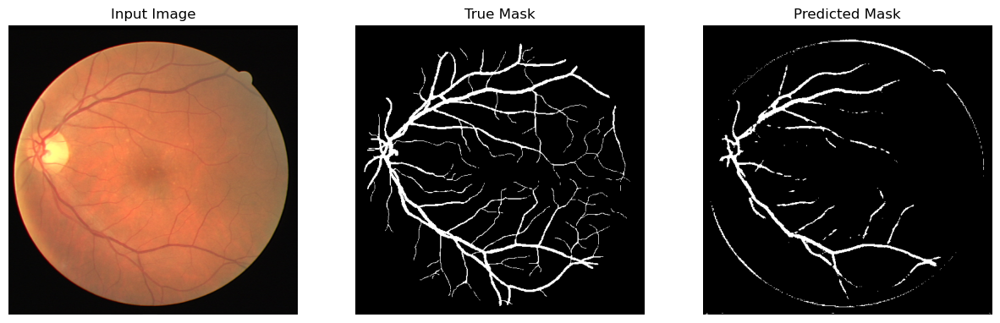


Sample Prediction after epoch 71

2/2 [==============================] - 200s 85s/step - loss: 0.2552 - accuracy: 0.9644
Epoch 72/200
2/2 [==============================] - 171s 64s/step - loss: 0.2532 - accuracy: 0.9647
Epoch 73/200
2/2 [==============================] - 166s 59s/step - loss: 0.2504 - accuracy: 0.9653
Epoch 74/200
2/2 [==============================] - 159s 61s/step - loss: 0.2490 - accuracy: 0.9653
Epoch 75/200
2/2 [==============================] - 166s 65s/step - loss: 0.2462 - accuracy: 0.9658
Epoch 76/200
1/1 [==============================] - 10s 10s/stepss: 0.2439 - accuracy: 0.9661


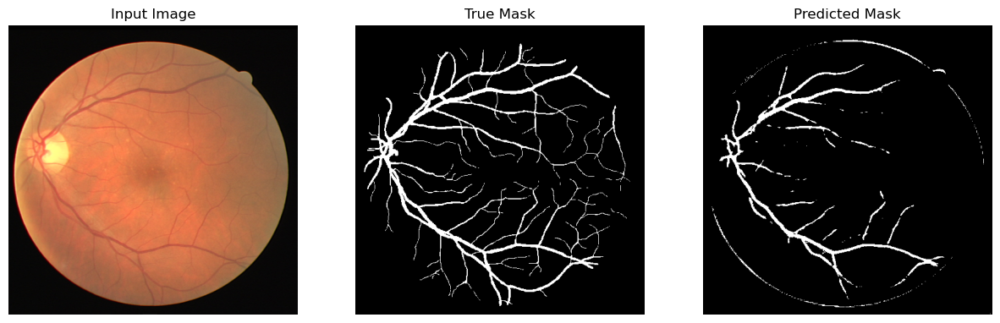


Sample Prediction after epoch 76

2/2 [==============================] - 173s 71s/step - loss: 0.2439 - accuracy: 0.9661
Epoch 77/200
2/2 [==============================] - 154s 62s/step - loss: 0.2418 - accuracy: 0.9665
Epoch 78/200
2/2 [==============================] - 138s 52s/step - loss: 0.2400 - accuracy: 0.9665
Epoch 79/200
2/2 [==============================] - 149s 54s/step - loss: 0.2381 - accuracy: 0.9668
Epoch 80/200
2/2 [==============================] - 143s 56s/step - loss: 0.2363 - accuracy: 0.9667
Epoch 81/200
1/1 [==============================] - 10s 10s/stepss: 0.2342 - accuracy: 0.9673


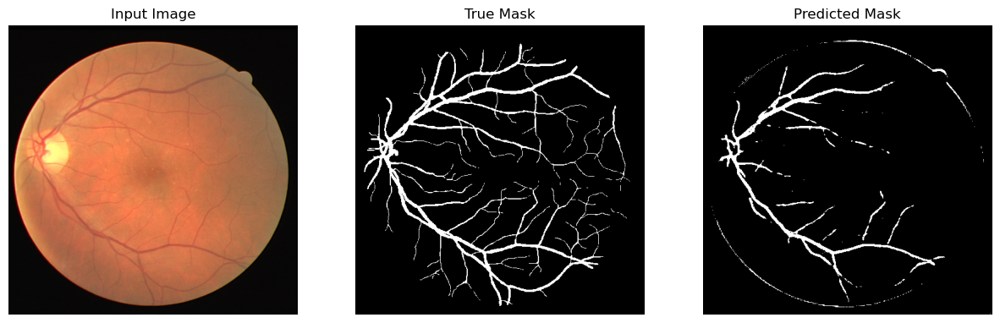


Sample Prediction after epoch 81

2/2 [==============================] - 163s 69s/step - loss: 0.2342 - accuracy: 0.9673
Epoch 82/200
2/2 [==============================] - 157s 52s/step - loss: 0.2324 - accuracy: 0.9675
Epoch 83/200
2/2 [==============================] - 143s 53s/step - loss: 0.2309 - accuracy: 0.9674
Epoch 84/200
2/2 [==============================] - 148s 53s/step - loss: 0.2290 - accuracy: 0.9677
Epoch 85/200
2/2 [==============================] - 124s 45s/step - loss: 0.2275 - accuracy: 0.9678
Epoch 86/200
1/1 [==============================] - 9s 9s/steploss: 0.2255 - accuracy: 0.9682


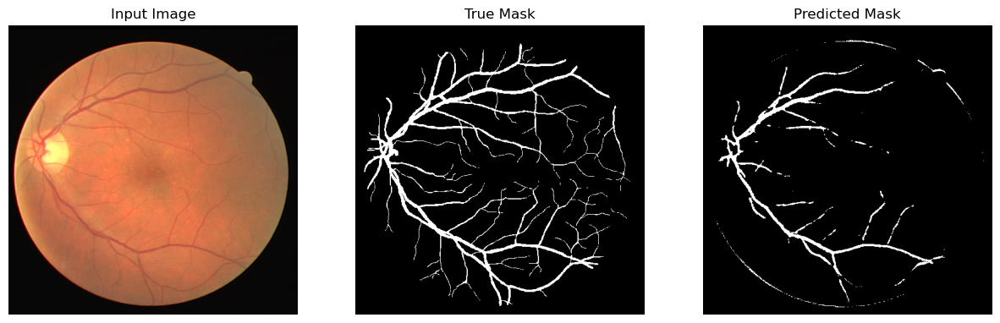


Sample Prediction after epoch 86

2/2 [==============================] - 152s 63s/step - loss: 0.2255 - accuracy: 0.9682
Epoch 87/200
2/2 [==============================] - 137s 51s/step - loss: 0.2242 - accuracy: 0.9682
Epoch 88/200
2/2 [==============================] - 136s 49s/step - loss: 0.2222 - accuracy: 0.9685
Epoch 89/200
2/2 [==============================] - 135s 51s/step - loss: 0.2209 - accuracy: 0.9684
Epoch 90/200
2/2 [==============================] - 134s 49s/step - loss: 0.2191 - accuracy: 0.9687
Epoch 91/200
1/1 [==============================] - 9s 9s/steploss: 0.2172 - accuracy: 0.9691


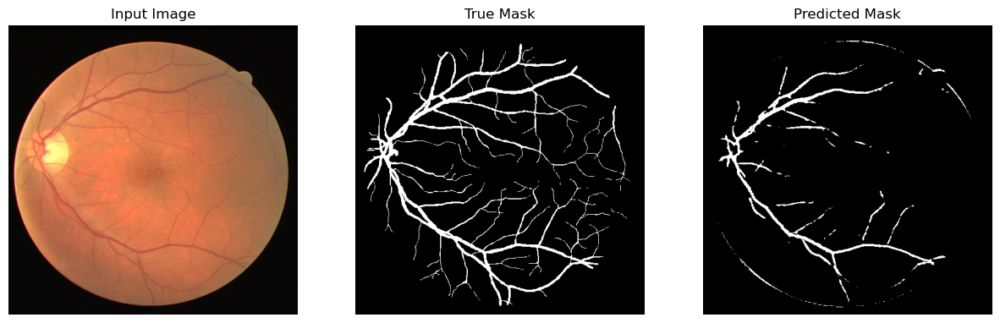


Sample Prediction after epoch 91

2/2 [==============================] - 148s 61s/step - loss: 0.2172 - accuracy: 0.9691
Epoch 92/200
2/2 [==============================] - 160s 77s/step - loss: 0.2157 - accuracy: 0.9693
Epoch 93/200
2/2 [==============================] - 149s 60s/step - loss: 0.2141 - accuracy: 0.9696
Epoch 94/200
2/2 [==============================] - 129s 46s/step - loss: 0.2131 - accuracy: 0.9695
Epoch 95/200
2/2 [==============================] - 130s 50s/step - loss: 0.2112 - accuracy: 0.9698
Epoch 96/200
1/1 [==============================] - 9s 9s/steploss: 0.2100 - accuracy: 0.9698


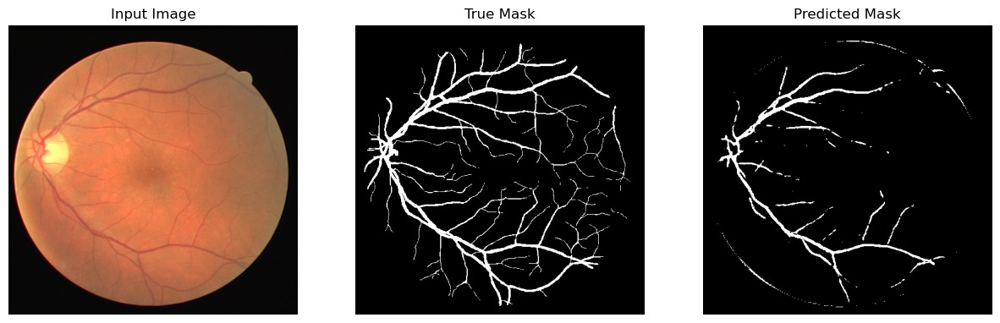


Sample Prediction after epoch 96

2/2 [==============================] - 138s 58s/step - loss: 0.2100 - accuracy: 0.9698
Epoch 97/200
2/2 [==============================] - 135s 49s/step - loss: 0.2088 - accuracy: 0.9699
Epoch 98/200
2/2 [==============================] - 128s 51s/step - loss: 0.2074 - accuracy: 0.9700
Epoch 99/200
2/2 [==============================] - 131s 47s/step - loss: 0.2057 - accuracy: 0.9704
Epoch 100/200
2/2 [==============================] - 128s 47s/step - loss: 0.2042 - accuracy: 0.9707
Epoch 101/200
1/1 [==============================] - 8s 8s/steploss: 0.2031 - accuracy: 0.9708


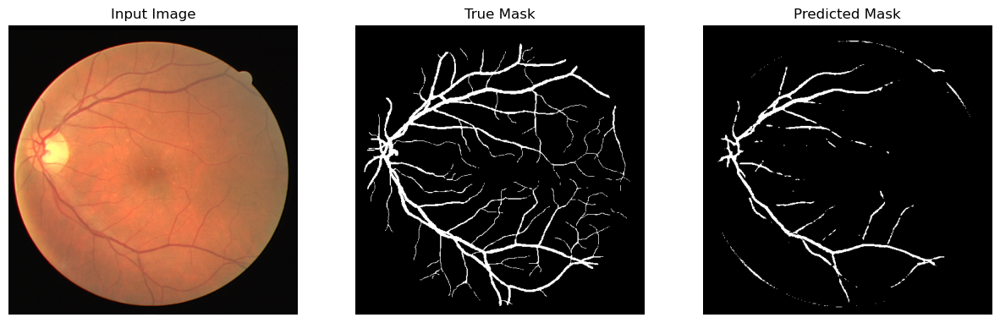


Sample Prediction after epoch 101

2/2 [==============================] - 156s 67s/step - loss: 0.2031 - accuracy: 0.9708
Epoch 102/200
2/2 [==============================] - 137s 50s/step - loss: 0.2023 - accuracy: 0.9706
Epoch 103/200
2/2 [==============================] - 135s 48s/step - loss: 0.2007 - accuracy: 0.9708
Epoch 104/200
2/2 [==============================] - 126s 45s/step - loss: 0.1997 - accuracy: 0.9709
Epoch 105/200
2/2 [==============================] - 131s 49s/step - loss: 0.1981 - accuracy: 0.9711
Epoch 106/200
1/1 [==============================] - 10s 10s/stepss: 0.1967 - accuracy: 0.9715


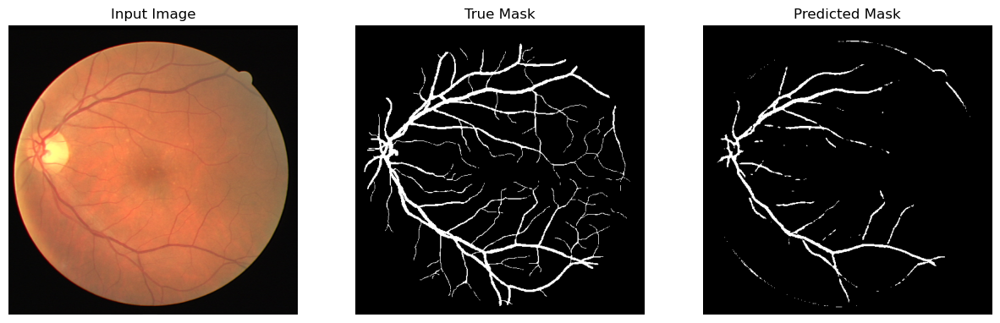


Sample Prediction after epoch 106

2/2 [==============================] - 170s 82s/step - loss: 0.1967 - accuracy: 0.9715
Epoch 107/200
2/2 [==============================] - 149s 60s/step - loss: 0.1961 - accuracy: 0.9713
Epoch 108/200
2/2 [==============================] - 148s 54s/step - loss: 0.1956 - accuracy: 0.9708
Epoch 109/200
2/2 [==============================] - 141s 55s/step - loss: 0.1935 - accuracy: 0.9717
Epoch 110/200
2/2 [==============================] - 167s 57s/step - loss: 0.1921 - accuracy: 0.9718
Epoch 111/200
1/1 [==============================] - 10s 10s/stepss: 0.1907 - accuracy: 0.9721


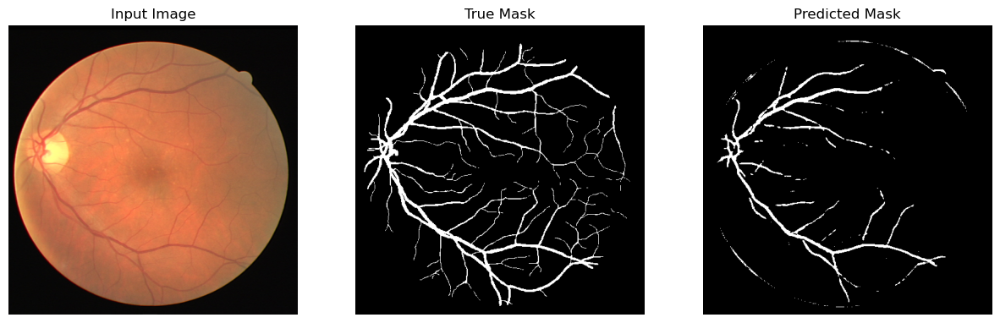


Sample Prediction after epoch 111

2/2 [==============================] - 141s 60s/step - loss: 0.1907 - accuracy: 0.9721
Epoch 112/200
2/2 [==============================] - 130s 49s/step - loss: 0.1901 - accuracy: 0.9720
Epoch 113/200
2/2 [==============================] - 131s 51s/step - loss: 0.1895 - accuracy: 0.9717
Epoch 114/200
2/2 [==============================] - 126s 47s/step - loss: 0.1877 - accuracy: 0.9722
Epoch 115/200
2/2 [==============================] - 127s 49s/step - loss: 0.1868 - accuracy: 0.9725
Epoch 116/200
1/1 [==============================] - 8s 8s/steploss: 0.1855 - accuracy: 0.9725


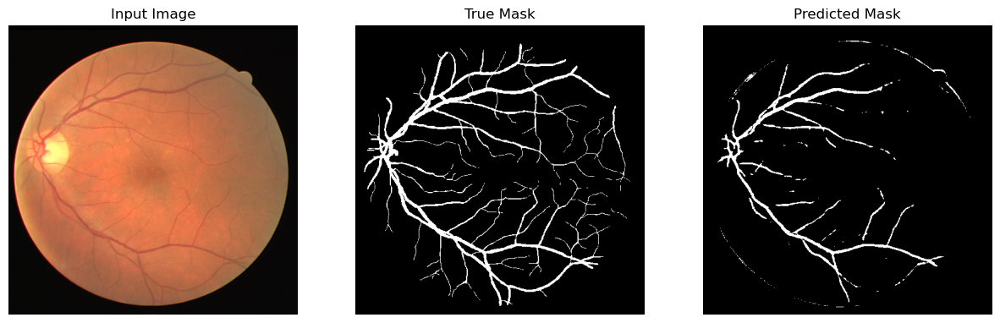


Sample Prediction after epoch 116

2/2 [==============================] - 135s 56s/step - loss: 0.1855 - accuracy: 0.9725
Epoch 117/200
2/2 [==============================] - 122s 44s/step - loss: 0.1855 - accuracy: 0.9718
Epoch 118/200
2/2 [==============================] - 119s 42s/step - loss: 0.1835 - accuracy: 0.9729
Epoch 119/200
2/2 [==============================] - 162s 49s/step - loss: 0.1825 - accuracy: 0.9729
Epoch 120/200
2/2 [==============================] - 125s 49s/step - loss: 0.1827 - accuracy: 0.9721
Epoch 121/200
1/1 [==============================] - 9s 9s/steploss: 0.1806 - accuracy: 0.9730


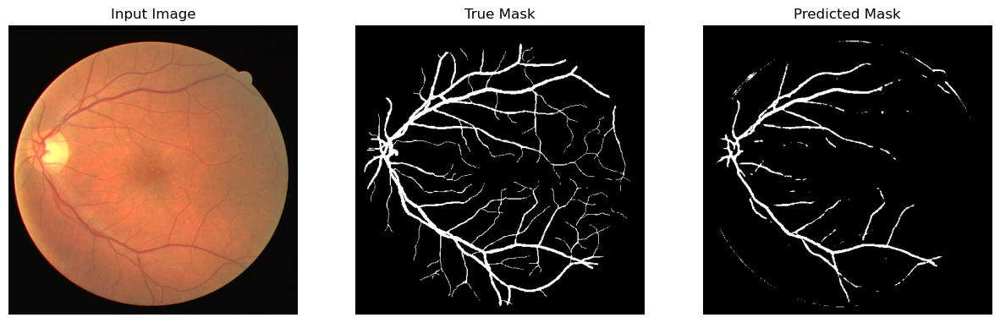


Sample Prediction after epoch 121

2/2 [==============================] - 132s 58s/step - loss: 0.1806 - accuracy: 0.9730
Epoch 122/200
2/2 [==============================] - 123s 46s/step - loss: 0.1794 - accuracy: 0.9732
Epoch 123/200
2/2 [==============================] - 133s 49s/step - loss: 0.1795 - accuracy: 0.9727
Epoch 124/200
2/2 [==============================] - 132s 48s/step - loss: 0.1784 - accuracy: 0.9727
Epoch 125/200
2/2 [==============================] - 124s 45s/step - loss: 0.1765 - accuracy: 0.9736
Epoch 126/200
1/1 [==============================] - 9s 9s/steploss: 0.1756 - accuracy: 0.9737


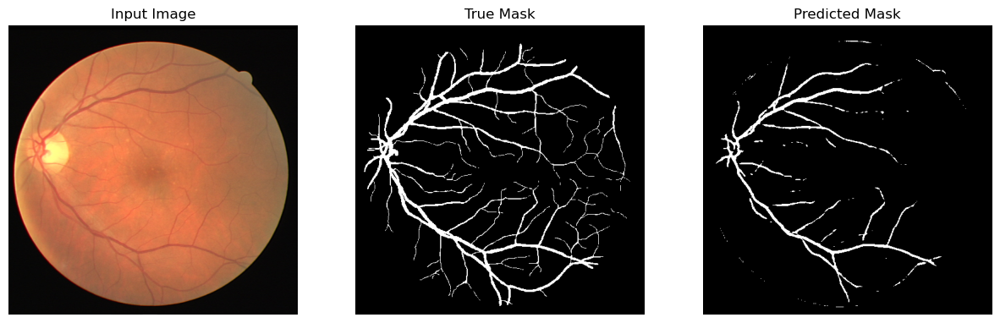


Sample Prediction after epoch 126

2/2 [==============================] - 133s 54s/step - loss: 0.1756 - accuracy: 0.9737
Epoch 127/200
2/2 [==============================] - 123s 47s/step - loss: 0.1752 - accuracy: 0.9733
Epoch 128/200
2/2 [==============================] - 127s 47s/step - loss: 0.1736 - accuracy: 0.9738
Epoch 129/200
2/2 [==============================] - 131s 51s/step - loss: 0.1726 - accuracy: 0.9740
Epoch 130/200
2/2 [==============================] - 123s 45s/step - loss: 0.1718 - accuracy: 0.9740
Epoch 131/200
1/1 [==============================] - 8s 8s/steploss: 0.1711 - accuracy: 0.9739


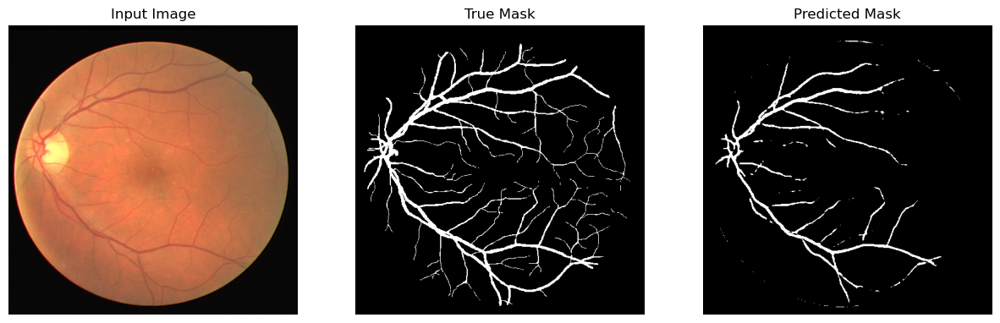


Sample Prediction after epoch 131

2/2 [==============================] - 137s 58s/step - loss: 0.1711 - accuracy: 0.9739
Epoch 132/200
2/2 [==============================] - 132s 50s/step - loss: 0.1705 - accuracy: 0.9739
Epoch 133/200
2/2 [==============================] - 138s 57s/step - loss: 0.1693 - accuracy: 0.9741
Epoch 134/200
2/2 [==============================] - 120s 45s/step - loss: 0.1686 - accuracy: 0.9741
Epoch 135/200
2/2 [==============================] - 136s 48s/step - loss: 0.1668 - accuracy: 0.9748
Epoch 136/200
1/1 [==============================] - 9s 9s/steploss: 0.1661 - accuracy: 0.9749


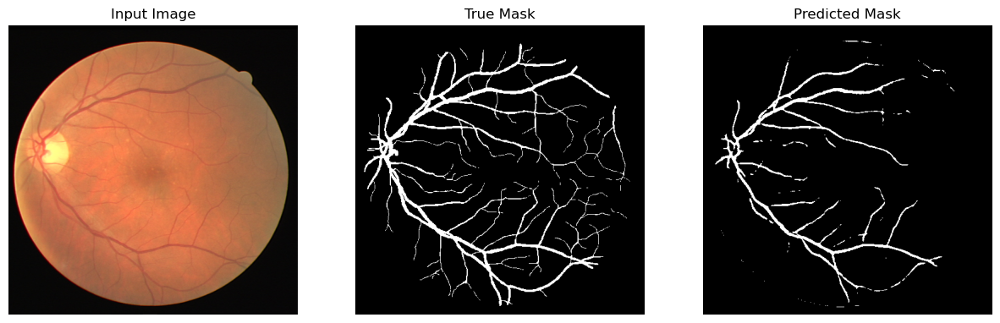


Sample Prediction after epoch 136

2/2 [==============================] - 150s 56s/step - loss: 0.1661 - accuracy: 0.9749
Epoch 137/200
2/2 [==============================] - 131s 52s/step - loss: 0.1657 - accuracy: 0.9747
Epoch 138/200
2/2 [==============================] - 139s 50s/step - loss: 0.1653 - accuracy: 0.9743
Epoch 139/200
2/2 [==============================] - 129s 50s/step - loss: 0.1640 - accuracy: 0.9748
Epoch 140/200
2/2 [==============================] - 132s 47s/step - loss: 0.1624 - accuracy: 0.9754
Epoch 141/200
1/1 [==============================] - 10s 10s/stepss: 0.1620 - accuracy: 0.9753


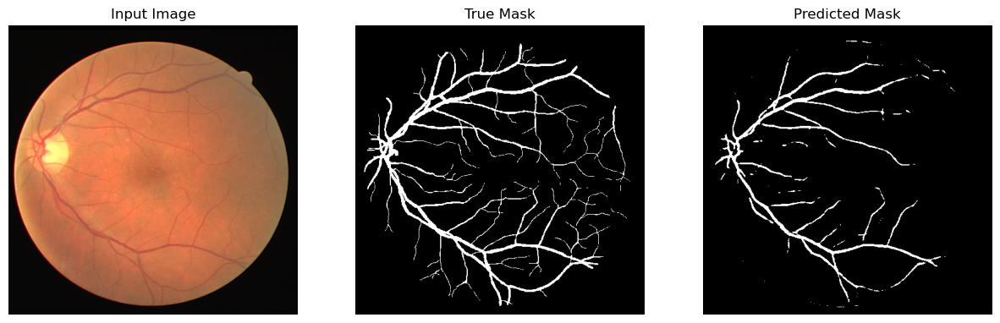


Sample Prediction after epoch 141

2/2 [==============================] - 147s 64s/step - loss: 0.1620 - accuracy: 0.9753
Epoch 142/200
2/2 [==============================] - 136s 50s/step - loss: 0.1614 - accuracy: 0.9751
Epoch 143/200
2/2 [==============================] - 138s 53s/step - loss: 0.1606 - accuracy: 0.9752
Epoch 144/200
2/2 [==============================] - 142s 57s/step - loss: 0.1594 - accuracy: 0.9755
Epoch 145/200
2/2 [==============================] - 150s 54s/step - loss: 0.1587 - accuracy: 0.9756
Epoch 146/200
1/1 [==============================] - 9s 9s/steploss: 0.1581 - accuracy: 0.9756


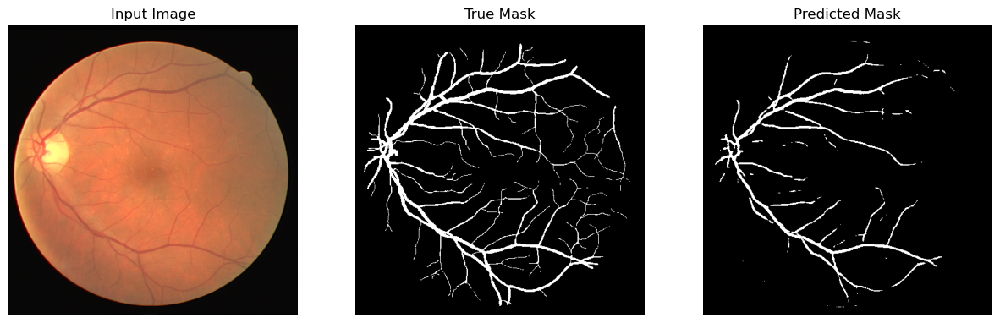


Sample Prediction after epoch 146

2/2 [==============================] - 181s 97s/step - loss: 0.1581 - accuracy: 0.9756
Epoch 147/200
2/2 [==============================] - 136s 45s/step - loss: 0.1572 - accuracy: 0.9756
Epoch 148/200
2/2 [==============================] - 132s 49s/step - loss: 0.1563 - accuracy: 0.9758
Epoch 149/200
2/2 [==============================] - 129s 52s/step - loss: 0.1552 - accuracy: 0.9762
Epoch 150/200
2/2 [==============================] - 128s 50s/step - loss: 0.1543 - accuracy: 0.9763
Epoch 151/200
1/1 [==============================] - 9s 9s/steploss: 0.1550 - accuracy: 0.9754


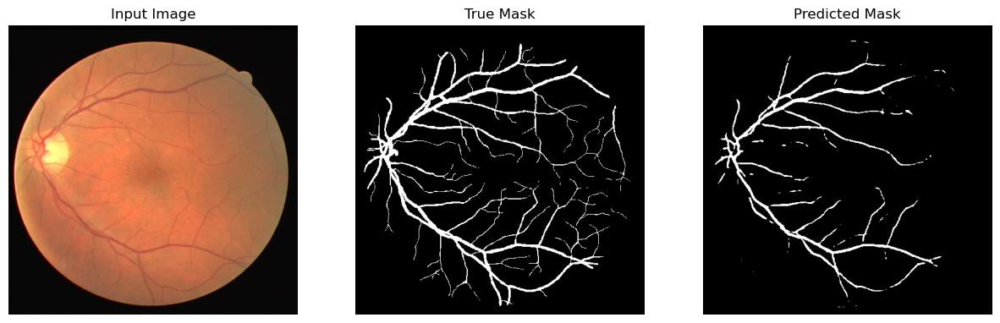


Sample Prediction after epoch 151

2/2 [==============================] - 135s 58s/step - loss: 0.1550 - accuracy: 0.9754
Epoch 152/200
2/2 [==============================] - 125s 47s/step - loss: 0.1532 - accuracy: 0.9761
Epoch 153/200
2/2 [==============================] - 124s 47s/step - loss: 0.1532 - accuracy: 0.9758
Epoch 154/200
2/2 [==============================] - 125s 45s/step - loss: 0.1517 - accuracy: 0.9764
Epoch 155/200
2/2 [==============================] - 125s 44s/step - loss: 0.1507 - accuracy: 0.9767
Epoch 156/200
1/1 [==============================] - 8s 8s/steploss: 0.1508 - accuracy: 0.9763


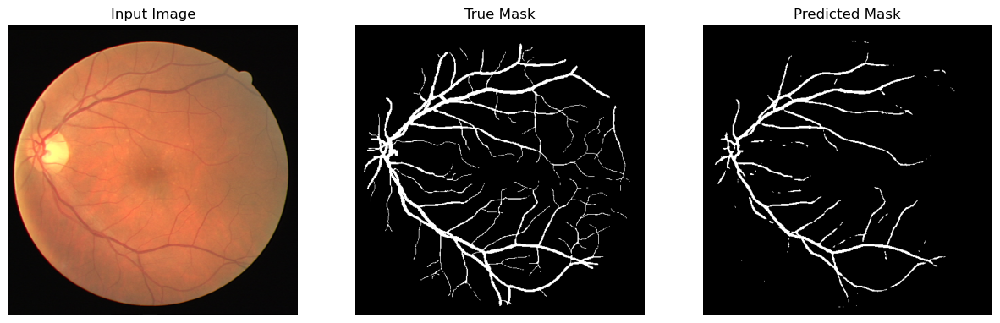


Sample Prediction after epoch 156

2/2 [==============================] - 139s 59s/step - loss: 0.1508 - accuracy: 0.9763
Epoch 157/200
2/2 [==============================] - 131s 50s/step - loss: 0.1494 - accuracy: 0.9767
Epoch 158/200
2/2 [==============================] - 136s 46s/step - loss: 0.1487 - accuracy: 0.9767
Epoch 159/200
2/2 [==============================] - 126s 46s/step - loss: 0.1478 - accuracy: 0.9771
Epoch 160/200
2/2 [==============================] - 153s 55s/step - loss: 0.1472 - accuracy: 0.9770
Epoch 161/200
1/1 [==============================] - 9s 9s/steploss: 0.1462 - accuracy: 0.9772


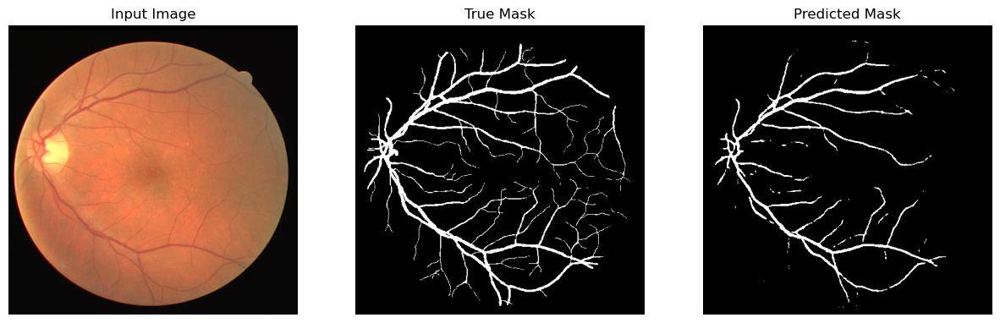


Sample Prediction after epoch 161

2/2 [==============================] - 150s 66s/step - loss: 0.1462 - accuracy: 0.9772
Epoch 162/200
2/2 [==============================] - 118s 40s/step - loss: 0.1454 - accuracy: 0.9774
Epoch 163/200
2/2 [==============================] - 166s 83s/step - loss: 0.1446 - accuracy: 0.9775
Epoch 164/200
2/2 [==============================] - 134s 52s/step - loss: 0.1435 - accuracy: 0.9779
Epoch 165/200
2/2 [==============================] - 143s 51s/step - loss: 0.1439 - accuracy: 0.9772
Epoch 166/200
1/1 [==============================] - 9s 9s/steploss: 0.1421 - accuracy: 0.9781


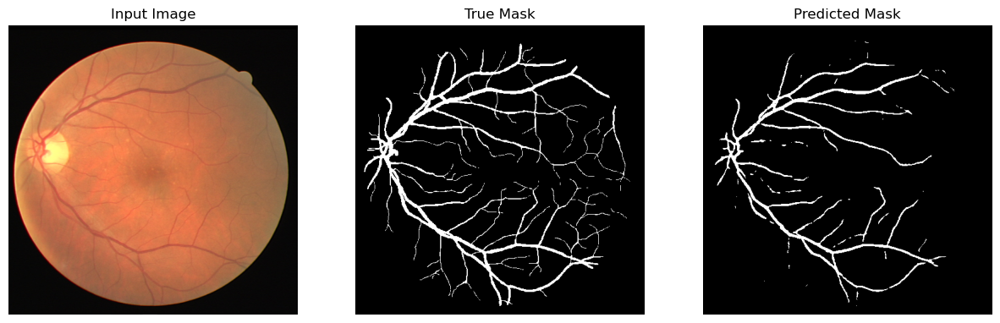


Sample Prediction after epoch 166

2/2 [==============================] - 142s 60s/step - loss: 0.1421 - accuracy: 0.9781
Epoch 167/200
2/2 [==============================] - 124s 46s/step - loss: 0.1420 - accuracy: 0.9778
Epoch 168/200
2/2 [==============================] - 129s 48s/step - loss: 0.1412 - accuracy: 0.9778
Epoch 169/200
2/2 [==============================] - 141s 62s/step - loss: 0.1416 - accuracy: 0.9772
Epoch 170/200
2/2 [==============================] - 134s 49s/step - loss: 0.1397 - accuracy: 0.9781
Epoch 171/200
1/1 [==============================] - 9s 9s/steploss: 0.1398 - accuracy: 0.9777


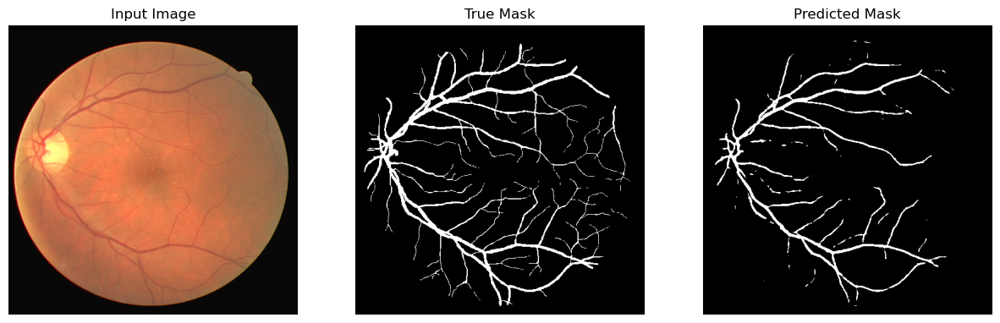


Sample Prediction after epoch 171

2/2 [==============================] - 142s 60s/step - loss: 0.1398 - accuracy: 0.9777
Epoch 172/200
2/2 [==============================] - 173s 92s/step - loss: 0.1384 - accuracy: 0.9783
Epoch 173/200
2/2 [==============================] - 143s 56s/step - loss: 0.1382 - accuracy: 0.9780
Epoch 174/200
2/2 [==============================] - 128s 50s/step - loss: 0.1372 - accuracy: 0.9785
Epoch 175/200
2/2 [==============================] - 135s 53s/step - loss: 0.1376 - accuracy: 0.9777
Epoch 176/200
1/1 [==============================] - 9s 9s/steploss: 0.1362 - accuracy: 0.9784


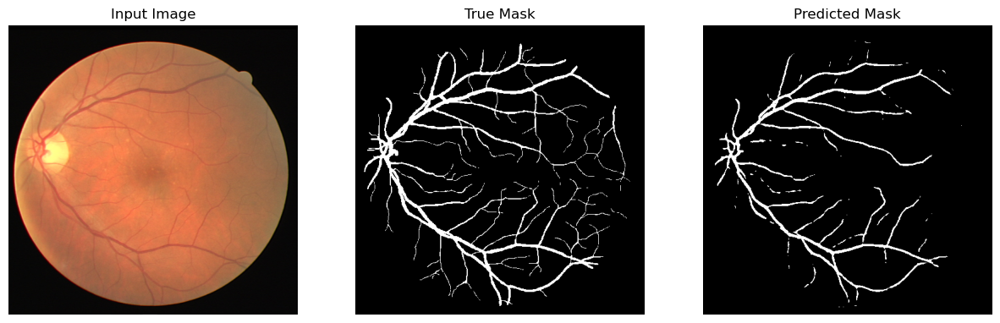


Sample Prediction after epoch 176

2/2 [==============================] - 139s 57s/step - loss: 0.1362 - accuracy: 0.9784
Epoch 177/200
2/2 [==============================] - 136s 44s/step - loss: 0.1365 - accuracy: 0.9779
Epoch 178/200
2/2 [==============================] - 133s 55s/step - loss: 0.1345 - accuracy: 0.9788
Epoch 179/200
2/2 [==============================] - 126s 47s/step - loss: 0.1352 - accuracy: 0.9779
Epoch 180/200
2/2 [==============================] - 133s 46s/step - loss: 0.1336 - accuracy: 0.9786
Epoch 181/200
1/1 [==============================] - 9s 9s/steploss: 0.1327 - accuracy: 0.9790


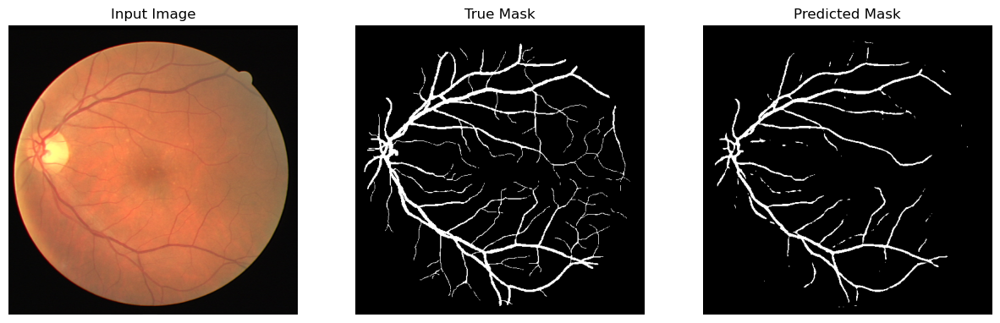


Sample Prediction after epoch 181

2/2 [==============================] - 136s 59s/step - loss: 0.1327 - accuracy: 0.9790
Epoch 182/200
2/2 [==============================] - 126s 47s/step - loss: 0.1329 - accuracy: 0.9785
Epoch 183/200
2/2 [==============================] - 138s 60s/step - loss: 0.1321 - accuracy: 0.9787
Epoch 184/200
2/2 [==============================] - 143s 51s/step - loss: 0.1308 - accuracy: 0.9792
Epoch 185/200
2/2 [==============================] - 128s 47s/step - loss: 0.1300 - accuracy: 0.9794
Epoch 186/200
1/1 [==============================] - 9s 9s/steploss: 0.1299 - accuracy: 0.9792


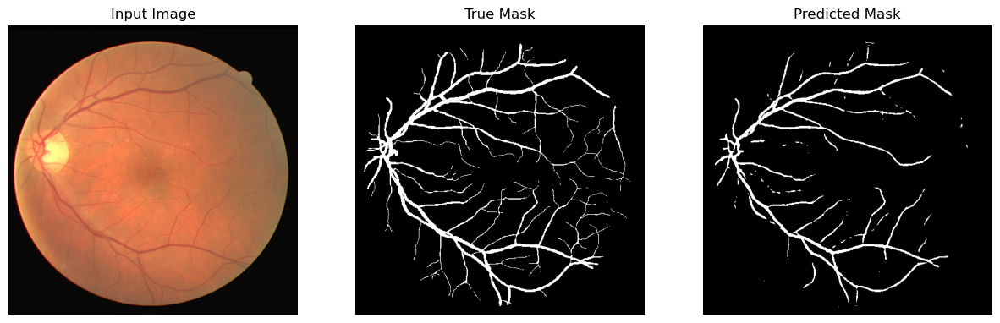


Sample Prediction after epoch 186

2/2 [==============================] - 149s 59s/step - loss: 0.1299 - accuracy: 0.9792
Epoch 187/200
2/2 [==============================] - 142s 56s/step - loss: 0.1287 - accuracy: 0.9796
Epoch 188/200
2/2 [==============================] - 143s 63s/step - loss: 0.1287 - accuracy: 0.9793
Epoch 189/200
2/2 [==============================] - 139s 55s/step - loss: 0.1281 - accuracy: 0.9793
Epoch 190/200
2/2 [==============================] - 128s 48s/step - loss: 0.1280 - accuracy: 0.9792
Epoch 191/200
1/1 [==============================] - 9s 9s/steploss: 0.1272 - accuracy: 0.9792


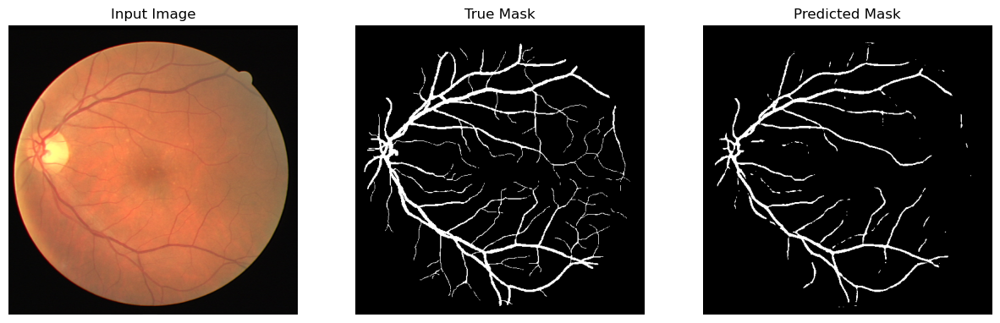


Sample Prediction after epoch 191

2/2 [==============================] - 146s 64s/step - loss: 0.1272 - accuracy: 0.9792
Epoch 192/200
2/2 [==============================] - 128s 46s/step - loss: 0.1259 - accuracy: 0.9799
Epoch 193/200
2/2 [==============================] - 131s 49s/step - loss: 0.1256 - accuracy: 0.9799
Epoch 194/200
2/2 [==============================] - 131s 49s/step - loss: 0.1250 - accuracy: 0.9800
Epoch 195/200
2/2 [==============================] - 126s 49s/step - loss: 0.1246 - accuracy: 0.9798
Epoch 196/200
1/1 [==============================] - 9s 9s/steploss: 0.1236 - accuracy: 0.9803


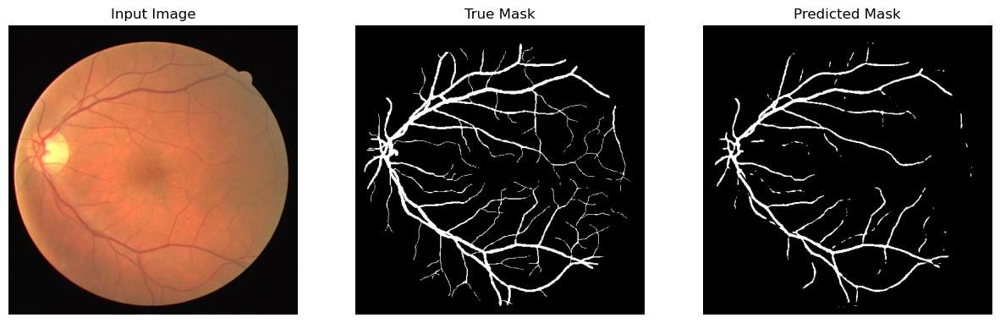


Sample Prediction after epoch 196

2/2 [==============================] - 136s 54s/step - loss: 0.1236 - accuracy: 0.9803
Epoch 197/200
2/2 [==============================] - 128s 47s/step - loss: 0.1235 - accuracy: 0.9801
Epoch 198/200
2/2 [==============================] - 126s 48s/step - loss: 0.1228 - accuracy: 0.9802
Epoch 199/200
2/2 [==============================] - 210s 48s/step - loss: 0.1235 - accuracy: 0.9793
Epoch 200/200
2/2 [==============================] - 127s 44s/step - loss: 0.1215 - accuracy: 0.9805


In [ ]:
# define optomizer
optim = keras.optimizers.Adam(0.0001)
bce   = keras.losses.BinaryCrossentropy()
metrics = ["accuracy"]

# compile keras model with defined optimozer, loss and metrics
model.compile(optim, bce, metrics)
callbacks = [
#         tf.keras.callbacks.EarlyStopping(patience=10, monitor='val_loss')]

model.fit(
    train_dataset,
    callbacks=[DisplayCallback(train_dataset)],
    epochs=200

)